## Aluno: Arthur Souto Lima

## Mat.: 2018055113

In [1]:
import matplotlib.pyplot as plt
from scipy import random
import numpy as np

# (a) Gerando caminhadas aleatórias

Escreva uma rotina para gerar caminhadas aleatórias de N passos em d  (=1 ou 2) dimensões, com cada passo uniformemente distribuído no intervalo (-1/2, 1/2) em cada dimensão. (Primeiro, gere os passos como um array N x d e, então, faça uma soma cumulativa.) 

In [2]:
def randomWalk(N, d):
    """
    Gera uma caminhada aleatória de dimensão d e N passos
    """
    steps = random.uniform(-0.5,0.5,(N,d))
    walks = np.cumsum(steps, axis=0)
    return walks


Faça um gráfico de $x_t$ por $t$ para poucas caminhadas de 10.000 passos. 

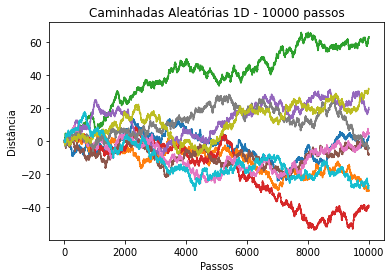

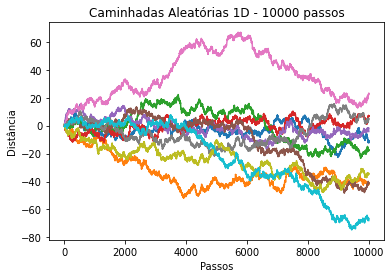

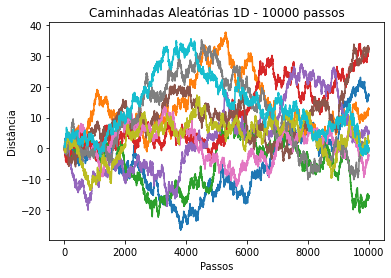

In [3]:
for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10000 passos")
    plt.plot(randomWalk(10000,1))
plt.show()

for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10000 passos")
    plt.plot(randomWalk(10000,1))
plt.show()

for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10000 passos")
    plt.plot(randomWalk(10000,1))
plt.show()



Se você multiplicar o número de passo por 100, a distância final da caminhada aumenta por cerca de 10 vezes?

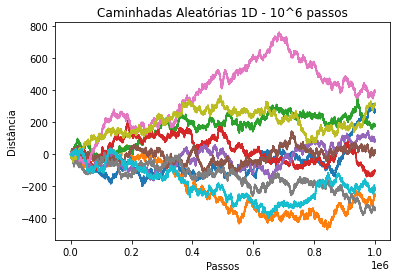

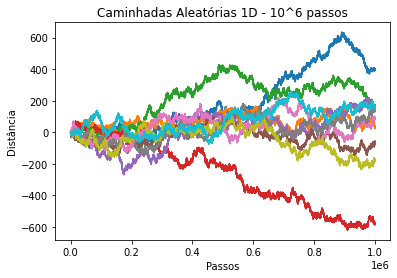

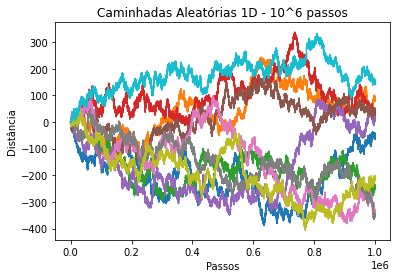

In [4]:
for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10^6 passos")
    plt.plot(randomWalk(10000*100,1))
plt.show()

for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10^6 passos")
    plt.plot(randomWalk(10000*100,1))
plt.show()

for i in range(10):
    plt.ylabel("Distância")
    plt.xlabel("Passos")
    plt.title("Caminhadas Aleatórias 1D - 10^6 passos")
    plt.plot(randomWalk(10000*100,1))
plt.show()

Comentário: com apenas 10000 passos, a distância final era menor que 100, normalmente entre -60 e 60. Quando usamos 100 vezes mais passos, a distância final passou a ser entre normalmente -600 e 600. Isso reafirma o proposto no enunciado

Faça um gráfico de x por y para poucas caminhadas aleatórias bidimensionais com N = 10, 1.000, e 100.000 (tente manter a razão de aspecto do gráfico XY em um.) 

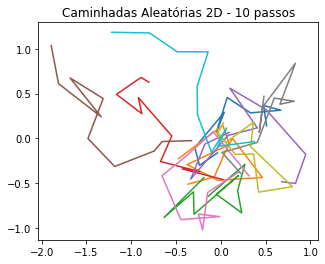

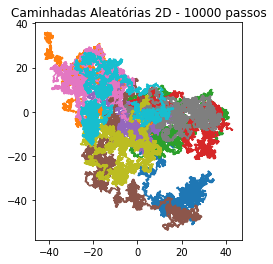

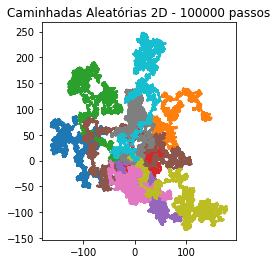

In [10]:
for N in [10,10000,100000]:
    for i in range(10):
        plt.title(f"Caminhadas Aleatórias 2D - {N} passos")
        walks = randomWalk(N,2)
        walks = np.array(walks).T
        axs = plt.gca()
        axs.set_aspect('equal', 'box')
        plt.plot(walks[0], walks[1])
    plt.show()

Comentário: é possível observar, por exemplo, a invariância de escala. Como dito no enunciado, apesar de aleatórias, o ensemble de caminhadas apresentam propriedades bem claras e perceptíveis. Quando observamos apenas as caminhadas em uma dimensão, apesar de distintas e algumas com mais passos que outras, elas têm propriedades semelhantes.

# (b) Pontos Finais das Caminhadas Aleatórias

Escreva uma rotina para determinar os pontos finais de W caminhadas aleatórias com N passos cada em d=2 dimensões. 

In [14]:
def endpoints(W, N, d):
    """
    Retorna os pontos finais de W caminhadas aleatórias de N passos, de dimensão d
    """
    endpoints_lst = []
    for i in range(W):
        # Cria uma caminhada aleatória com N passos de dimensão d
        steps = randomWalk(N,d)
        # Acha o ponto final dela e adiciona à lista
        endpoints_lst.append(np.sum(steps, axis=0))    
    return endpoints_lst
endpoints(10, 10000, 2)

[array([-41987.92353896, -88928.60306671]),
 array([93545.53431531, 82255.90789958]),
 array([ 24972.58846737, 117406.15220217]),
 array([-160867.27542064, -148765.23538615]),
 array([114352.1772222 , 152911.70960909]),
 array([-124959.93716384, -307031.98001235]),
 array([-90887.74129452, 154504.75719203]),
 array([380155.17373775,  63829.16444208]),
 array([395211.99579462,  31827.22578658]),
 array([176815.31240318, 217747.41963735])]

Faça um gráfico de dispersão das coordenadas finais de 10.000 caminhadas aleatórias com N=1 e 10, superpostos no mesmo gráfico.  

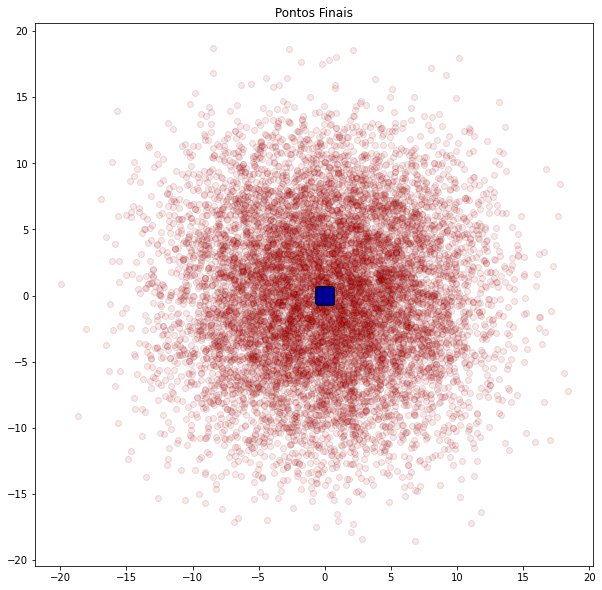

In [41]:
plt.figure(figsize=(10,10))
plt.title("Pontos Finais")

# N = 10
ends = endpoints(10000, 10, 2)
ends = np.array(ends).T
axs = plt.gca()
axs.set_aspect('equal')
plt.scatter(ends[0], ends[1], edgecolors='black', alpha=.1, color='r')

# N = 1
ends = endpoints(10000, 1, 2)
ends = np.array(ends).T
axs = plt.gca()
axs.set_aspect('equal')
plt.scatter(ends[0], ends[1], edgecolors='black', alpha=.1, color='b')
plt.show()


Comentário: esse gráfico nos mostra o conceito da Simetria Rotacional Emergente das caminhadas aleatórias. Com poucos passos, no caso apenas 1, os pontos finais tendem a um quadrado. Porém, no que aumentamos a quantidade de passos, os pontos finais se distribuem de forma circular em torno da origem, mais concentrados nela.

# (c) Teorema Central do Limite 

Calcule o desvio quadrático médio (RMS), a para passos uniformemente distribuidos no intervalo (-1/2, 1/2) em uma dimensão. Escreva uma rotina que plota um histograma dos pontos finais de W caminhadas aleatórias com N passos e 50 caixas (bins), junto com a previsão da equação acima para x no intervalo (-3\sigma, 3\sigma). Faça um histograma com W=10.000 e N=1, 2, 3 e 5. Quão rápido a distribuição Gaussiana se torna uma boa aproximação para uma caminhada aleatória?

In [113]:
def histAndGauss(N):
    """
    Plota um histograma de pontos finais de 10000 caminhadas aleatórias com de N passos, de dimensão 1
    Plota no mesmo gráfico uma distribuição gaussiana esse parâmetro N 
    """
    # Cria o histograma
    plt.figure(figsize=(5,5))
    plt.title(f"N = {N}")
    end = endpoints(10000,N,1)
    end = np.array(end)
    plt.hist(end,bins=50,density=True,stacked=True);

    # Cria a curva gaussiana
    sigma = np.sqrt(N)
    x = np.arange(-3.*sigma, 3.*sigma, 0.1*sigma)
    gauss = (1/(np.sqrt(2*np.pi)*sigma)) * np.exp((-x**2/(2*sigma**2)))
    plt.plot(x,gauss,'r');
    plt.show()

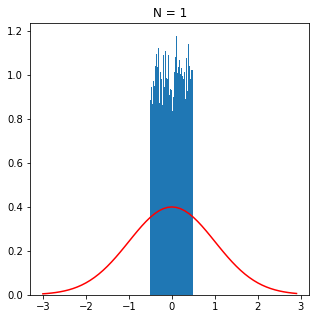

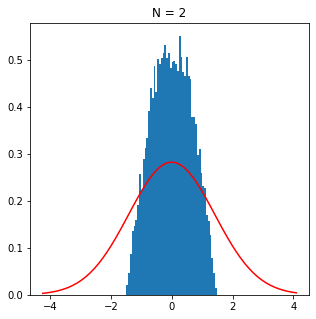

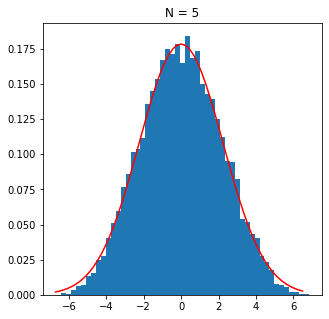

In [114]:
histAndGauss(1)
histAndGauss(2)
histAndGauss(5)


Comentário: com cerca de apenas 5 passos, a caminhada aleatória já se aproxima de uma distribuição normal gaussiana. Isso também corrobora com os resultados encontrados no item anterior da simetria emergente de 1 passo e de mais passos.